# Springback UV map

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
plt.rcParams['figure.dpi'] = 120
import os
import sys
sys.path.insert(0, "../src")
from cut_predictor import ProjectionPredictor

In [2]:
os.listdir("../models/")

['joining_xyz.pkl',
 'best_web_model',
 'best_3d_model',
 'springback_uvmap_xyz.pkl',
 'cut_x0.pkl',
 'best_uv_xyz_model',
 'best_joining_thickness_model',
 'best_x0_model',
 'best_uv_thickness_model',
 'joining_thickness.pkl',
 '3d.pkl',
 'best_joining_xyz_model',
 'springback_uvmap_thickness.pkl']

In [3]:
reg = ProjectionPredictor()
reg.load_config('../models/springback_uvmap_xyz.pkl')
reg.load_network('../models/best_uv_xyz_model/')

In [4]:
import plotly
import plotly.graph_objs as go
plotly.offline.init_notebook_mode()

def plotly_show_surface(x, y):
    # Configure the trace.
    trace = go.Scatter3d(
        x=y[0, :, :].flatten(),  
        y=y[1, :, :].flatten(),
        z=y[2, :, :].flatten(),
        mode='markers',
        marker={
            'size': 0.2,
            'opacity': 0.8,
        }
    )

    # Configure the layout.
    layout = go.Layout(
        margin={'l': 0, 'r': 0, 'b': 0, 't': 0}
    )

    plot_figure = go.Figure(data=[trace], layout=layout)

    # Render the plot.
    plotly.offline.iplot(plot_figure)


%matplotlib inline
plt.rcParams['figure.dpi'] = 150

def mpl_show_surface(x, y):

    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    p = ax.scatter(
        y[0, :, :].flatten(),  
        y[1, :, :].flatten(),
        y[2, :, :].flatten(),
        s=0.001
    )
    plt.show()



62/62 [==============================] - 1s 14ms/step


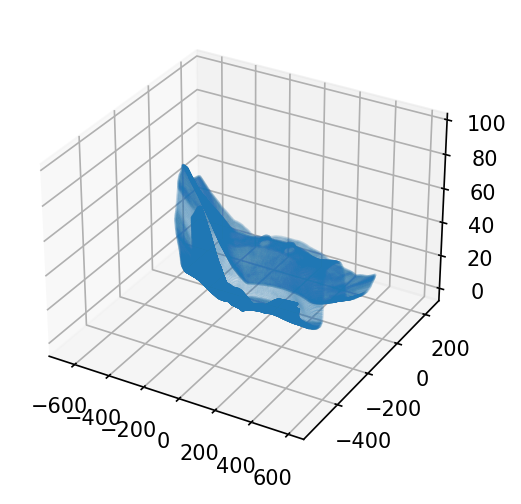

In [5]:
x, y = reg.predict({
        'Blechdicke': 1.01, 
        'Niederhalterkraft': 400.0, 
        'Ziehspalt': 2.4, 
        'Einlegeposition': -5, 
        'Ziehtiefe': 30,
        'Stempel_ID': 3,
        'E': 191.37245,
        'Rp0': 138.22696,
        'Rp50': 449.528189,
    }, 
    positions=(500, 500))

mpl_show_surface(x, y)

In [6]:
reg.interactive(mpl_show_surface, positions=(500, 500))

interactive(children=(FloatSlider(value=1.1883700000000001, description='Blechdicke', max=1.48, min=0.99, step…

In [7]:
x, y = reg.predict({
        'Blechdicke': 1.01, 
        'Niederhalterkraft': 110.0, 
        'Ziehspalt': 2.4, 
        'Einlegeposition': -5, 
        'Ziehtiefe': 30,
        'Stempel_ID': 3,
        'E': 191.37245,
        'Rp0': 238.22696,
        'Rp50': 449.528189,
    }, 
    positions=(500, 500))

plotly_show_surface(x, y)

62/62 [==============================] - 1s 14ms/step


In [8]:
x

array([[0.        , 0.        ],
       [0.        , 0.00200401],
       [0.        , 0.00400802],
       ...,
       [1.        , 0.99599198],
       [1.        , 0.99799599],
       [1.        , 1.        ]])

In [9]:
y

array([[[  10.697006,    9.294479,    7.890686, ..., -661.63855 ,
         -662.31146 , -663.0034  ],
        [  11.538269,   10.136673,    8.733322, ..., -660.3117  ,
         -660.99054 , -661.68274 ],
        [  12.379623,   10.978226,    9.576202, ..., -658.9795  ,
         -659.66986 , -660.3618  ],
        ...,
        [ 607.7346  ,  606.28125 ,  604.828   , ...,  404.7397  ,
          403.6621  ,  402.72406 ],
        [ 609.06793 ,  607.61456 ,  606.1712  , ...,  407.6057  ,
          406.4298  ,  405.3769  ],
        [ 610.4017  ,  608.9574  ,  607.5113  , ...,  410.42993 ,
          409.289   ,  408.16266 ]],

       [[-538.4601  , -536.90875 , -535.3531  , ...,  212.86728 ,
          214.7544  ,  216.68918 ],
        [-538.4532  , -536.9052  , -535.3514  , ...,  212.78024 ,
          214.69333 ,  216.62811 ],
        [-538.4465  , -536.8986  , -535.3497  , ...,  212.69974 ,
          214.63245 ,  216.56702 ],
        ...,
        [-550.0888  , -548.77576 , -547.4628  , ...,  

In [10]:
y.shape

(3, 500, 500)

In [11]:
y[:,0,0]

array([  10.697006, -538.4601  ,   74.870766], dtype=float32)

In [12]:
x.shape

(250000, 2)

In [13]:
reg.mean_values

{'Blechdicke': 1.1883700000000001,
 'Niederhalterkraft': 251.12,
 'Einlegeposition': -0.422,
 'Rp0': 209.94203270100002,
 'u': 0.5000000000000004,
 'v': 0.539314938076683,
 'x': -1.276415721995169e-07,
 'y': -2.8129751603888002,
 'z': 20.35027773864645}

In [14]:
df = pd.DataFrame({"v":np.linspace(0.,1.,100), "u":0.5})
df

,v,u
0,0.000000,0.5
1,0.010101,0.5
2,0.020202,0.5
3,0.030303,0.5
4,0.040404,0.5
...,...,...
95,0.959596,0.5
96,0.969697,0.5
97,0.979798,0.5
98,0.989899,0.5


In [15]:
param = {
        'Blechdicke': 1.01, 
        'Niederhalterkraft': 110.0, 
        'Ziehspalt': 2.4, 
        'Einlegeposition': -5, 
        'Ziehtiefe': 30,
        'Stempel_ID': 3,
        'E': 191.37245,
        'Rp0': 238.22696,
        'Rp50': 449.528189,
    }

1/1 [==============================] - 0s 13ms/step


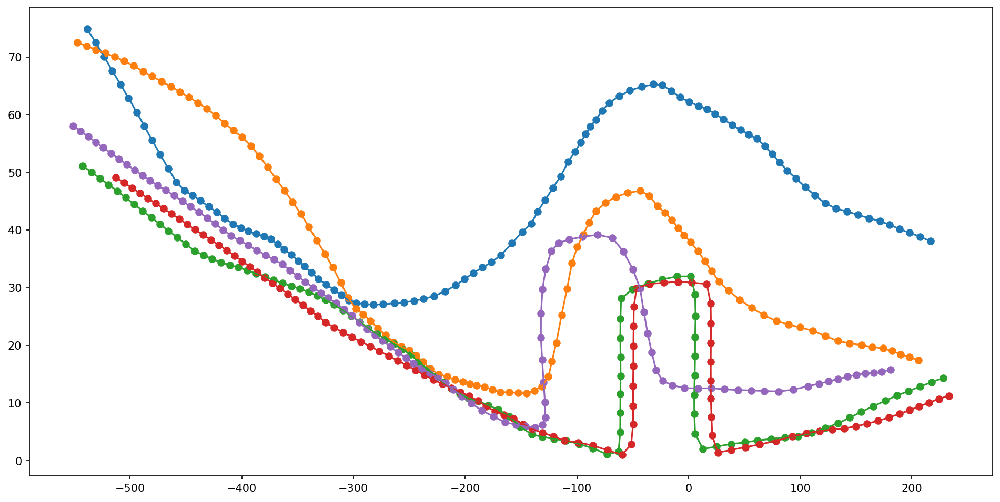

In [16]:
B = 400/25.4
H = 200/25.4
fig, ax = plt.subplots(1, figsize=(B, H))
for u in np.linspace(0.,1,5):
    df = pd.DataFrame({"v": np.linspace(0.,1,100), "u": u})
    dfr = reg.predict_df(param, df)
    ax.scatter(dfr.y, dfr.z)
    ax.plot(dfr.y, dfr.z)
#dfr

1/1 [==============================] - 0s 15ms/step


Text(0.5, 1.0, 'x0cut from springback_uv')

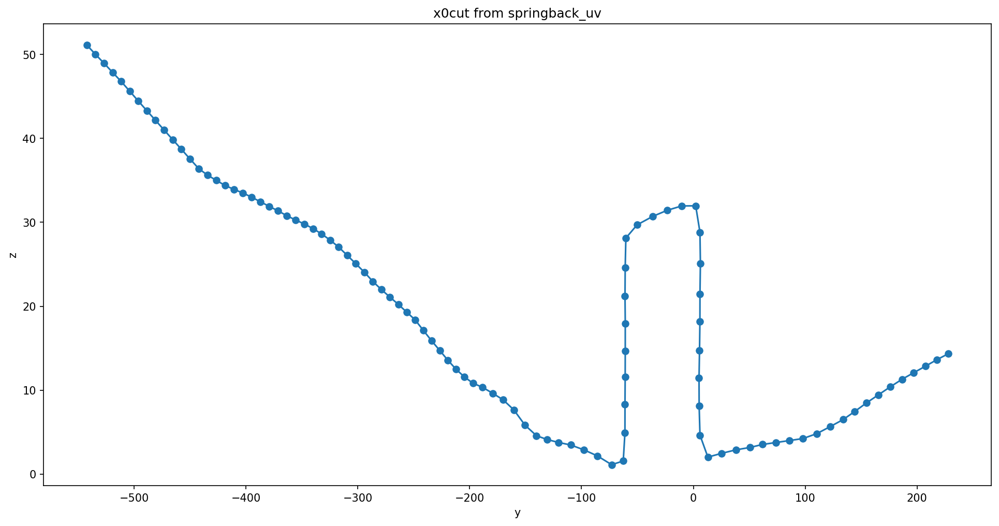

In [17]:
param = {
        'Blechdicke': 1.01, 
        'Niederhalterkraft': 110.0, 
        'Ziehspalt': 2.4, 
        'Einlegeposition': -5, 
        'Ziehtiefe': 30,
        'Stempel_ID': 3,
        'E': 191.37245,
        'Rp0': 238.22696,
        'Rp50': 449.528189,
    }
df = pd.DataFrame({"v": np.linspace(0.,1,100), "u": .5})
dfr = reg.predict_df(param, df)
B = 400/25.4
H = 200/25.4
fig, ax = plt.subplots(1, figsize=(B, H))
ax.scatter(dfr.y, dfr.z)
ax.plot(dfr.y, dfr.z)
ax.set_xlabel("y")
ax.set_ylabel("z")
ax.set_title("x0cut from springback_uv")

1/1 [==============================] - 0s 12ms/step


(0.0, 79.01339797973633)

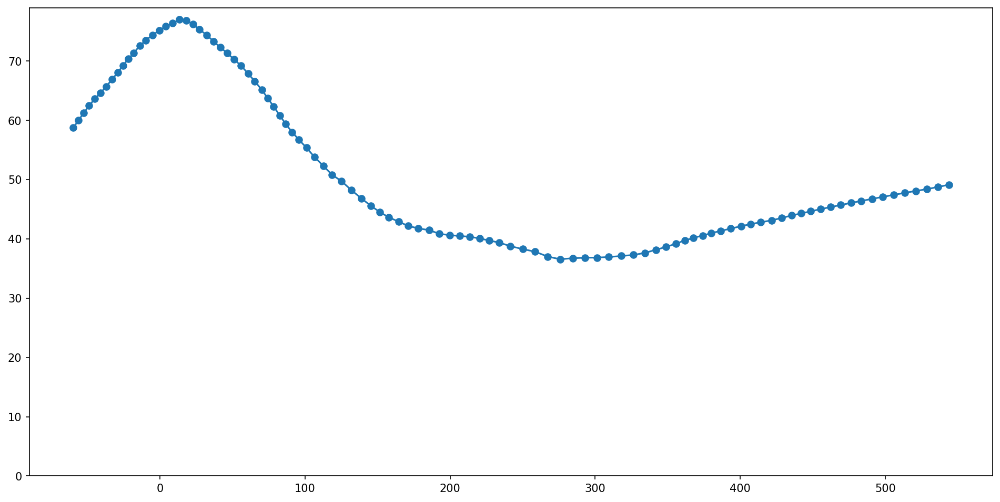

In [18]:
df = pd.DataFrame({"u": np.linspace(0.,1.,100), "v": 0.1})
dfr = reg.predict_df({
        'Blechdicke': 1.01, 
        'Niederhalterkraft': 510.0, 
        'Ziehspalt': 2.4, 
        'Einlegeposition': -5, 
        'Ziehtiefe': 30,
        'Stempel_ID': 3,
        'E': 191.37245,
        'Rp0': 238.22696,
        'Rp50': 449.528189,
    }, 
    df)
B = 400/25.4
H = 200/25.4
fig, ax = plt.subplots(1, figsize=(B, H))
ax.scatter(dfr.x, dfr.z)
ax.plot(dfr.x, dfr.z)
ax.set_ylim(0, None)

1/1 [==============================] - 0s 15ms/step


Text(0.5, 1.0, 'x0cut - variation ')

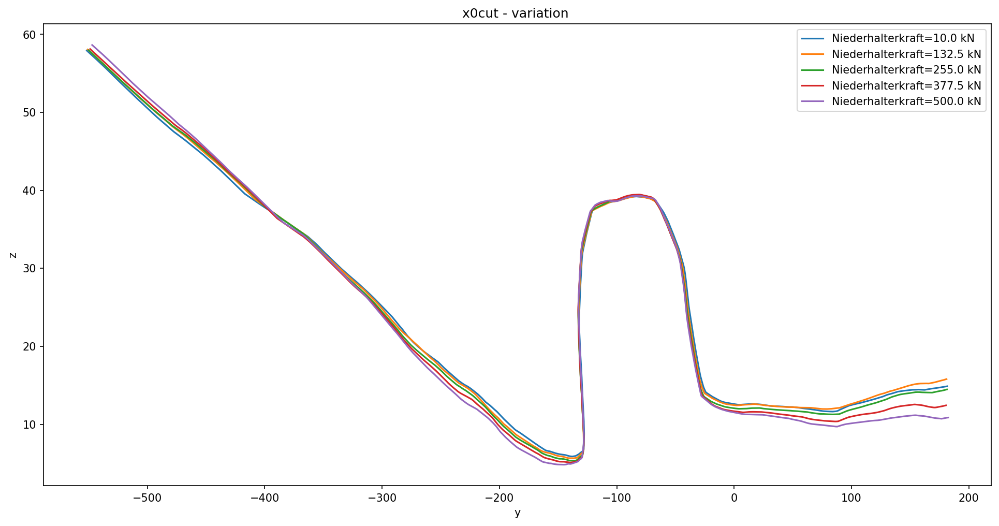

In [19]:
param = {
        'Blechdicke': 1.01, 
        'Niederhalterkraft': 110.0, 
        'Ziehspalt': 2.4, 
        'Einlegeposition': -5, 
        'Ziehtiefe': 30,
        'Stempel_ID': 3,
        'E': 191.37245,
        'Rp0': 238.22696,
        'Rp50': 449.528189,
    }

parameter_name = 'Niederhalterkraft'
B = 400/25.4
H = 200/25.4
fig, ax = plt.subplots(1, figsize=(B, H))
df = pd.DataFrame({"v": np.linspace(0.,1,1000), "u": u})
for pvalue in np.linspace(reg.min_values[parameter_name], reg.max_values[parameter_name], 5):
    param[parameter_name] = pvalue
    dfr = reg.predict_df(param, df)
    #ax.scatter(dfr.y, dfr.z)
    ax.plot(dfr.y, dfr.z, label=f"{parameter_name}={pvalue:.1f} kN")
ax.legend(loc="best")
ax.set_xlabel("y")
ax.set_ylabel("z")
ax.set_title("x0cut - variation ")

1/1 [==============================] - 0s 15ms/step


Text(0.5, 1.0, 'x0cut - variation ')

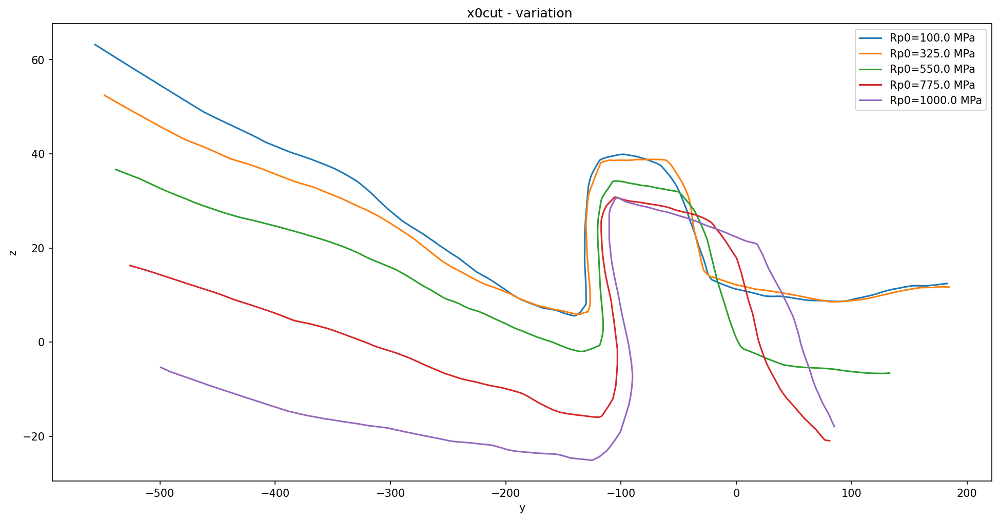

In [20]:
param = {
        'Blechdicke': 1.01, 
        'Niederhalterkraft': 110.0, 
        'Ziehspalt': 2.4, 
        'Einlegeposition': -5, 
        'Ziehtiefe': 30,
        'Stempel_ID': 3,
        'E': 191.37245,
        'Rp0': 238.22696,
        'Rp50': 449.528189,
    }

parameter_name = 'Rp0'
B = 400/25.4
H = 200/25.4
fig, ax = plt.subplots(1, figsize=(B, H))
df = pd.DataFrame({"v": np.linspace(0.,1,1000), "u": u})
for pvalue in np.linspace(100, 1000, 5):
    param[parameter_name] = pvalue
    param['Rp50'] = pvalue*2
    
    dfr = reg.predict_df(param, df)
    #ax.scatter(dfr.y, dfr.z)
    ax.plot(dfr.y, dfr.z, label=f"{parameter_name}={pvalue:.1f} MPa")
ax.legend(loc="best")
ax.set_xlabel("y")
ax.set_ylabel("z")
ax.set_title("x0cut - variation ")

1/1 [==============================] - 0s 15ms/step


Text(0.5, 1.0, 'x0cut - variation ')

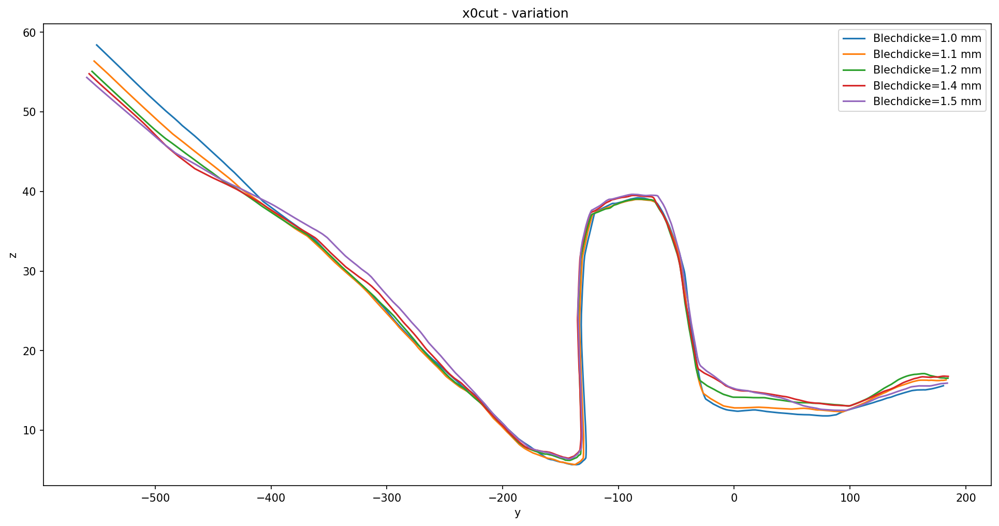

In [21]:
param = {
        'Blechdicke': 1.01, 
        'Niederhalterkraft': 110.0, 
        'Ziehspalt': 2.4, 
        'Einlegeposition': -5, 
        'Ziehtiefe': 30,
        'Stempel_ID': 3,
        'E': 191.37245,
        'Rp0': 238.22696,
        'Rp50': 449.528189,
    }

parameter_name = 'Blechdicke'
B = 400/25.4
H = 200/25.4
fig, ax = plt.subplots(1, figsize=(B, H))
df = pd.DataFrame({"v": np.linspace(0.,1,1000), "u": u})
for pvalue in np.linspace(reg.min_values[parameter_name], reg.max_values[parameter_name], 5):
    param[parameter_name] = pvalue
    dfr = reg.predict_df(param, df)
    #ax.scatter(dfr.y, dfr.z)
    ax.plot(dfr.y, dfr.z, label=f"{parameter_name}={pvalue:.1f} mm")
ax.legend(loc="best")
ax.set_xlabel("y")
ax.set_ylabel("z")
ax.set_title("x0cut - variation ")

1/1 [==============================] - 0s 15ms/step


Text(0.5, 1.0, 'x0cut - variation ')

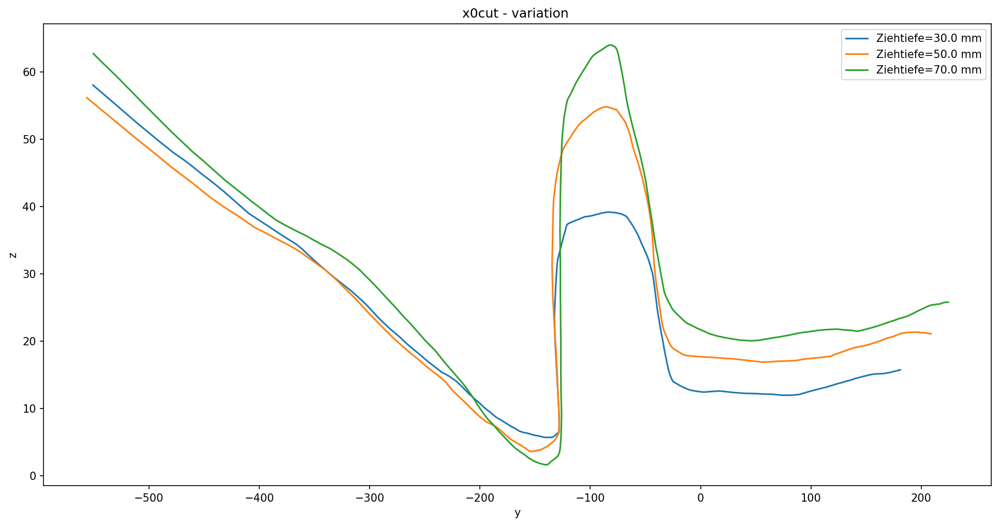

In [22]:
param = {
        'Blechdicke': 1.01, 
        'Niederhalterkraft': 110.0, 
        'Ziehspalt': 2.4, 
        'Einlegeposition': -5, 
        'Ziehtiefe': 30,
        'Stempel_ID': 3,
        'E': 191.37245,
        'Rp0': 238.22696,
        'Rp50': 449.528189,
    }

parameter_name = 'Ziehtiefe'
B = 400/25.4
H = 200/25.4
fig, ax = plt.subplots(1, figsize=(B, H))
df = pd.DataFrame({"v": np.linspace(0.,1,1000), "u": u})
#for pvalue in np.linspace(reg.min_values[parameter_name], reg.max_values[parameter_name], 5):
for pvalue in [30, 50, 70]:
    param[parameter_name] = pvalue
    dfr = reg.predict_df(param, df)
    #ax.scatter(dfr.y, dfr.z)
    ax.plot(dfr.y, dfr.z, label=f"{parameter_name}={pvalue:.1f} mm")
ax.legend(loc="best")
ax.set_xlabel("y")
ax.set_ylabel("z")
ax.set_title("x0cut - variation ")

1/1 [==============================] - 0s 12ms/step


Text(0.5, 1.0, 'flange cut - variation ')

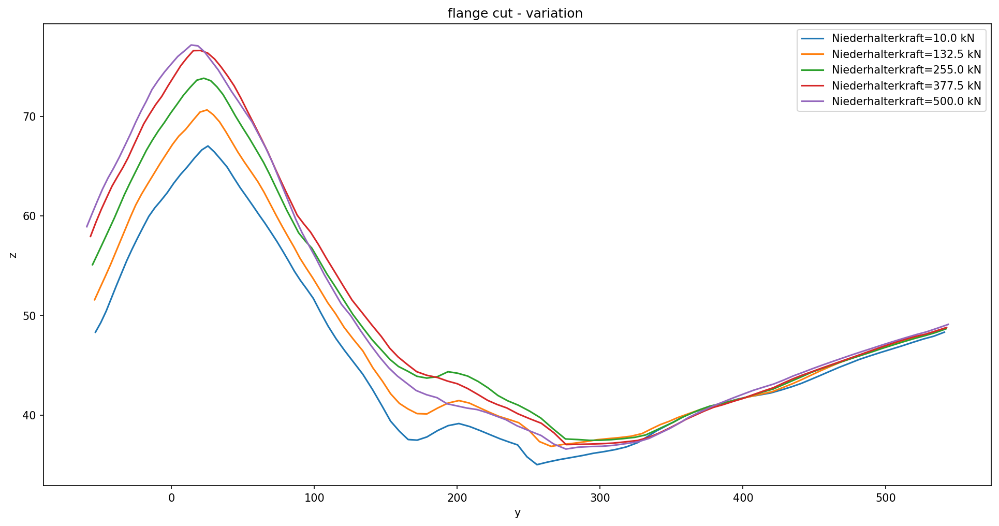

In [23]:
param = {
        'Blechdicke': 1.01, 
        'Niederhalterkraft': 110.0, 
        'Ziehspalt': 2.4, 
        'Einlegeposition': -5, 
        'Ziehtiefe': 30,
        'Stempel_ID': 3,
        'E': 191.37245,
        'Rp0': 238.22696,
        'Rp50': 449.528189,
    }

parameter_name = 'Niederhalterkraft'
B = 400/25.4
H = 200/25.4
fig, ax = plt.subplots(1, figsize=(B, H))
df = pd.DataFrame({"u": np.linspace(0.,1.,100), "v": 0.1})
for pvalue in np.linspace(reg.min_values[parameter_name], reg.max_values[parameter_name], 5):
    param[parameter_name] = pvalue
    dfr = reg.predict_df(param, df)
    #ax.scatter(dfr.y, dfr.z)
    ax.plot(dfr.x, dfr.z, label=f"{parameter_name}={pvalue:.1f} kN")
ax.legend(loc="best")
ax.set_xlabel("y")
ax.set_ylabel("z")
ax.set_title("flange cut - variation ")

In [24]:
reg.min_values['Niederhalterkraft'], reg.max_values['Niederhalterkraft']

(10, 500)

In [29]:
import scale.fem.lsdyna.api as api
mesh2d = api.BoxMesh2d(size=[1,1,0], elsize=.01, pid=1)
mesh2d.gen_box()
mesh2d.info()
mesh2d.nodes


,nid,x,y,z
1,1,0.0,0.0,0.0
2,2,0.01,0.0,0.0
3,3,0.02,0.0,0.0
4,4,0.03,0.0,0.0
5,5,0.04,0.0,0.0
...,...,...,...,...
10197,10197,0.96,1.0,0.0
10198,10198,0.97,1.0,0.0
10199,10199,0.98,1.0,0.0
10200,10200,0.99,1.0,0.0


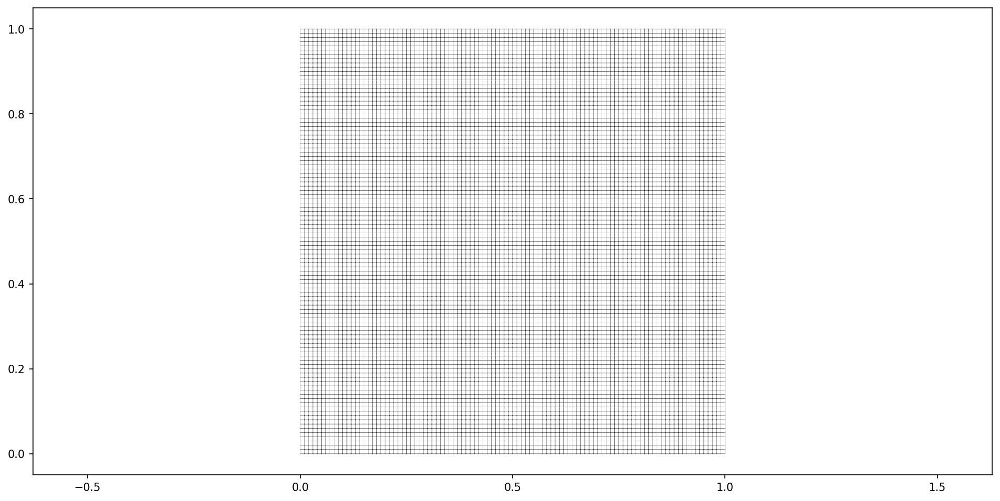

In [30]:
B = 400/25.4
H = 200/25.4
fig, ax = plt.subplots(1, figsize=(B, H))
ax.set_aspect("equal", "datalim")
mesh2d.plot_mpl(ax=ax)

#mesh.nodes.u *=.99
#mesh.nodes.v *=.99

In [32]:
mesh = mesh2d.copy()
mesh.nodes = mesh.nodes.rename(columns={"x":"u", "y":"v", "z":"w"})

mesh.nodes

,nid,u,v,w
1,1,0.0,0.0,0.0
2,2,0.01,0.0,0.0
3,3,0.02,0.0,0.0
4,4,0.03,0.0,0.0
5,5,0.04,0.0,0.0
...,...,...,...,...
10197,10197,0.96,1.0,0.0
10198,10198,0.97,1.0,0.0
10199,10199,0.98,1.0,0.0
10200,10200,0.99,1.0,0.0


In [35]:
param = {
        'Blechdicke': 1.01, 
        'Niederhalterkraft': 410.0, 
        'Ziehspalt': 2.4, 
        'Einlegeposition': -5, 
        'Ziehtiefe': 70,
        'Stempel_ID': 3,
        'E': 191.37245,
        'Rp0': 238.22696,
        'Rp50': 449.528189,
    }

reg.predict(param, mesh.nodes[["u", "v"]])

UnboundLocalError: local variable 'nb_points' referenced before assignment

In [ ]:
df = pd.DataFrame({"u":[1], "v": [1]})
param = {
        'Blechdicke': 1.01, 
        'Niederhalterkraft': 410.0, 
        'Ziehspalt': 2.4, 
        'Einlegeposition': -5, 
        'Ziehtiefe': 30,
        'Stempel_ID': 3,
        'E': 191.37245,
        'Rp0': 238.22696,
        'Rp50': 449.528189,
    }
reg.predict_df(param, df)

In [ ]:
B = 400/25.4
H = 200/25.4
fig, ax = plt.subplots(1, figsize=(B, H))
ax.set_aspect("equal", "datalim")
mesh.plot_mpl(ax=ax)

In [ ]:
mesh.show_in()

In [ ]:
mesh.nodes